# Q-Learning For House Navigation Task


In [1]:
# Here we will use numpy arrays
import numpy as np
import pandas as pd
import random

## Define State and Action spaces

Here we use discrete sets of states and actions.


In [2]:
grid_size = 5

person_reward = -5
dirt_collect_reward = 5
no_collect_reward = -5
goal_reward = 10
move_reward = -1

person_locations = [(3, 2), (1, 3)]
dirt_locations = [(2, 4), (1, 2), (3, 1)]
final_state = (grid_size - 1, grid_size - 1)

environment = np.ones((grid_size, grid_size), dtype=np.int32) * move_reward

# Persons (-ve reward)
for x, y in person_locations:
    environment[x, y] = person_reward

# Dirt (+ve reward)
for x, y in dirt_locations:
    environment[x, y] = dirt_collect_reward

# Return home
environment[final_state[0], final_state[1]] = goal_reward
environment

array([[-1, -1, -1, -1, -1],
       [-1, -1,  5, -5, -1],
       [-1, -1, -1, -1,  5],
       [-1,  5, -5, -1, -1],
       [-1, -1, -1, -1, 10]], dtype=int32)

In [3]:
S = []
for i in range(grid_size):
    for j in range(grid_size):
        if (i, j) in person_locations:
            S.append(f'{i}_{j}_0_1')
        elif (i, j) in dirt_locations:
            S.append(f'{i}_{j}_1_0')
        else:
            S.append(f'{i}_{j}_0_0')
A = ['U', 'D', 'L', 'R', 'C']
S

['0_0_0_0',
 '0_1_0_0',
 '0_2_0_0',
 '0_3_0_0',
 '0_4_0_0',
 '1_0_0_0',
 '1_1_0_0',
 '1_2_1_0',
 '1_3_0_1',
 '1_4_0_0',
 '2_0_0_0',
 '2_1_0_0',
 '2_2_0_0',
 '2_3_0_0',
 '2_4_1_0',
 '3_0_0_0',
 '3_1_1_0',
 '3_2_0_1',
 '3_3_0_0',
 '3_4_0_0',
 '4_0_0_0',
 '4_1_0_0',
 '4_2_0_0',
 '4_3_0_0',
 '4_4_0_0']

In [4]:
from typing import Tuple


def parse_state(state: str) -> Tuple[int, int, str]:
    x, y, dirt, person = state.split("_")

    return x, y, dirt == 1, person == 1


def get_next_state(x: int, y: int) -> str:
    for s in S:
        if f'{x}_{y}' in s:
            return s


def execute_action(state: str, action: str) -> str:
    x, y, _, _ = parse_state(state)

    if action == "U":
        if y == 0:
            raise ValueError("Can't move up")
        y -= 1
    elif action == "D":
        if y == grid_size - 1:
            raise ValueError("Can't move down")
        y += 1
    elif action == "L":
        if x == 0:
            raise ValueError("Can't move left")
        x -= 1
    elif action == "R":
        if x == grid_size - 1:
            raise ValueError("Can't move right")
        x += 1

    next_state = get_next_state(x, y)
    x_new, y_new, dirt, person = parse_state(next_state)
    reward = -1
    if dirt:
        reward = 5
        dirt = 0
        i = S.index(next_state)
        next_state = f'{x_new}_{y_new}_{dirt}_{person}'
        S[i] = next_state
    if person:
        reward = -5
    if x_new == final_state[0] and y_new == final_state[1]:
        reward = 10
    return reward, next_state

## Define R Matrix

R matrix indicates the actions which are possible from any given state, along with the numeric reward for every possible action in each state.

The R matrix is part of the environment. It is constructed by the task designer, and the agent is unable to change it in any way.

We use **np.NaN** (i.e. "not a number") to indicate actions which are impossible.

Note: Numpy indexes by 0, so the indices in the R matrix for this example go from 0 to 5 instead of 1 to 6.

nan indicates impossible move <br>
100 indicates destination (door)


In [5]:
R = np.full((len(S), len(A)), np.nan)

for row, _ in enumerate(environment):
    for column, _ in enumerate(environment[row]):
        if row > 0:
            if (row-1, column) in person_locations:
                R[row * grid_size + column, 0] = person_reward
            elif (row - 1, column) == final_state:
                R[row * grid_size + column, 0] = goal_reward
            else:
                R[row * grid_size + column, 0] = -1
        if row < grid_size - 1:
            if (row+1, column) in person_locations:
                R[row * grid_size + column, 1] = person_reward
            elif (row - 1, column) == final_state:
                R[row * grid_size + column, 1] = goal_reward
            else:
                R[row * grid_size + column, 1] = -1
        if column > 0:
            if (row, column-1) in person_locations:
                R[row * grid_size + column, 2] = person_reward
            elif (row - 1, column) == final_state:
                R[row * grid_size + column, 2] = goal_reward
            else:
                R[row * grid_size + column, 2] = -1
        if column < grid_size - 1:
            if (row, column+1) in person_locations:
                R[row * grid_size + column, 3] = person_reward
            elif (row - 1, column) == final_state:
                R[row * grid_size + column, 3] = goal_reward
            else:
                R[row * grid_size + column, 3] = -1
        if (row, column) in dirt_locations:
            R[row * grid_size + column, 4] = dirt_collect_reward
        else:
            R[row * grid_size + column, 4] = no_collect_reward


print(R)

R_df = pd.DataFrame(R, columns=A, index=S)

R_df

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]]


,U,D,L,R,C
0_0_0_0,NaN,-1.0,NaN,-1.0,-5.0
0_1_0_0,NaN,-1.0,-1.0,-1.0,-5.0
0_2_0_0,NaN,-1.0,-1.0,-1.0,-5.0
0_3_0_0,NaN,-5.0,-1.0,-1.0,-5.0
0_4_0_0,NaN,-1.0,-1.0,NaN,-5.0
1_0_0_0,-1.0,-1.0,NaN,-1.0,-5.0
1_1_0_0,-1.0,-1.0,-1.0,-1.0,-5.0
1_2_1_0,-1.0,-1.0,-1.0,-5.0,5.0
1_3_0_1,-1.0,-1.0,-1.0,-1.0,-5.0
1_4_0_0,-1.0,-1.0,-5.0,NaN,-5.0


## Define Q Matrix

The Q matrix indicates the agent's valuation for the given state and action pair. In other words, the agent's expected return for taking the given action in the given state.

When the agent knows the number of possible states and actions already, the Q matrix is the same size as the R matrix. The indices are the same, ie row 0 indicates state A etc in the Q matrix as well as the R matrix.

We initialize the Q matrix with zeros. Right now, the agent **doesn't know anything about the value of any given action in any given state, and it also doesn't know which actions are possible in which state yet.**


In [6]:
Q = np.zeros(R.shape)

print('Q matrix: \n\n{}'.format(Q))

Q matrix: 

[[0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]]


## Begin!

Okay now we're ready for our agent to start learning. We will do the first timestep step-by-step to see how it works, and then see how it all comes together by looping over timesteps within a single episode.

### Initialize State

Here we randomly initialize the state (ie randomly select which room the agent starts in) to begin the episode.


In [7]:
# FILL IN

s = 0

print("Starting state is '{}', which is row {} in the Q and R matrices".format(
    S[s], s))

Starting state is '0_0_0_0', which is row 0 in the Q and R matrices


### Identify Available Actions for State

Now we identify which are our available actions in this state from the R matrix.

Note: the available actions are the elements which are NOT nan from the row of the R matrix corresponding to current state.


In [8]:
available_actions = np.where(~np.isnan(R[s]))[0]
print(available_actions)

[1 3 4]


In [9]:
R[s]

array([nan, -1., nan, -1., -5.])

In [10]:
a_idx = list(available_actions)
a_labels = [A[x] for x in available_actions]
q_values = [Q[s, a] for a in a_idx]

print('Available actions are: {}'.format(a_labels))
print('Those actions correspond to column indices: {}'.format(a_idx))
print('Those actions have estimated values: {}'.format(q_values))

Available actions are: ['D', 'R', 'C']
Those actions correspond to column indices: [1, 3, 4]
Those actions have estimated values: [0.0, 0.0, 0.0]


### Select Action

Here we are using a **greedy behavioural policy**, so we always choose the action with the highest value. Ties are broken at random.

Later in the notebook we switch to epsilon-greedy, which chooses a greedy action with probability 0.9 and a random action with probability 0.1.


In [11]:
best_actions = available_actions[np.where(q_values == np.max(q_values))[0]]
best_actions_labels = [A[x] for x in best_actions]
best_actions_q_values = [Q[s, a] for a in best_actions]

In [12]:
print(f"best actions (indices) are {best_actions}")
print(f"The labels associated with the best actions are {best_actions_labels}")
print(f"q values for the best actions are {best_actions_q_values}")

best actions (indices) are [1 3 4]
The labels associated with the best actions are ['D', 'R', 'C']
q values for the best actions are [0.0, 0.0, 0.0]


In [13]:
print("Our best available actions from state '{}' are: {} with current q values: {}".format(S[s],
                                                                                            best_actions_labels, best_actions_q_values))

a = np.random.choice(best_actions)

print("Randomly selecting action '{}' with current Q value {}".format(
    A[a], Q[s, a]))

Our best available actions from state '0_0_0_0' are: ['D', 'R', 'C'] with current q values: [0.0, 0.0, 0.0]
Randomly selecting action 'R' with current Q value 0.0


## Update Environment (According to Action Selected by Agent)

### Determine reward

The reward is issued by the environment given the state and action pair


In [14]:
r = R[s, a]
print("Reward for taking action '{}' from state '{}': {}".format(
    A[a], S[s], r))

Reward for taking action 'R' from state '0_0_0_0': -1.0


### Update State

The environment state updates given the state action pair


In [15]:
s_old = s
# here, the transition function is deterministic. Next state corresponds simply to the action taken.
if A[a] == 'U':
    s -= 5
elif A[a] == 'D':
    s += 5
elif A[a] == 'L':
    s -= 1
elif A[a] == 'R':
    s += 1
print("After taking action '{}' from state '{}', new state is '{}'".format(
    A[a], S[s_old], S[s]))

After taking action 'R' from state '0_0_0_0', new state is '0_1_0_0'


## Update Q Matrix

Now that the agent has observed some reward, it can update its internal value estimates.

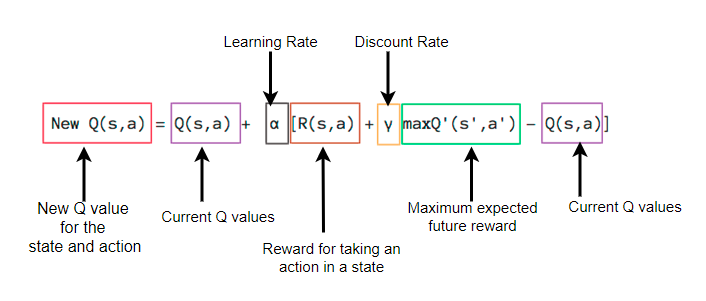


### Parameters Initializations


In [16]:
alpha = 1
gamma = 0.8
epsilon = 0.9

### Use the equation above to update Q Values

Specifically we are going to update Q[s_old,a] value <br>
**to think. What is maxQ(s,a) in the equation?**


## Run An Episode

Run the cell below to run a single episode.

All information is printed in the cell output.

How many episodes do you have to run to get to the final Q values?


## Run Until Convergence

Run many episodes until Q matrix converges to final values


In [22]:
def epsilon_greedy(R, A, goal_state, alpha=1, gamma=0.8, epsilon=0.9, episodes=1000, timestep_per_episode=500):
    print(R, A, goal_state, alpha, gamma,
          epsilon, episodes, timestep_per_episode)
    Q = np.zeros(R.shape)
    episode_means = []
    episode_rewards = []
    # Run for episodes
    for episode in range(episodes):
        s = 0

        episode_reward = 0
        for _ in range(timestep_per_episode):
            # Action selection
            available_actions = np.where(~np.isnan(R[s]))[0]
            q_values = [Q[s, a] for a in available_actions]
            best_actions = available_actions[np.where(
                q_values == np.max(q_values))[0]]
            best_actions_q_values = [Q[s, x] for x in best_actions]

            # Epsilon-greedy
            if np.random.uniform() > epsilon:
                a = np.random.choice(available_actions)
            else:
                a = np.random.choice(best_actions)

            # Environment updating

            r = R[s, a]

            state_name = S[s]
            x, y, dirt, person = parse_state(state_name)
            if (x, y) in dirt_locations and a == 4:
                dirt_locations.remove((x, y))
                R[s, a] = move_reward
            s_old = s
            # here, the transition function is deterministic. Next state corresponds simply to the action taken.
            if A[a] == 'U':
                s -= 5
            elif A[a] == 'D':
                s += 5
            elif A[a] == 'L':
                s -= 1
            elif A[a] == 'R':
                s += 1

            episode_reward += r

            # FILL IN

            # Q value updating
            Q[s_old, a] += alpha * \
                (r + gamma * np.max(Q[s]) - Q[s_old, a])

            if S[s] == goal_state:
                break

        print('Episode {} finished. Q matrix values:\n{}'.format(episode, Q.round(1)))
        episode_means.append(np.mean(Q))
        episode_rewards.append(episode_reward)
    return episode_means, episode_rewards, Q

# Further exercises:

- Explore the impact of different parameters (e.g. learning rate, discount rate), experiment with different values
- Plot observations for different parameter values
- Perform a grid search to find the optimal combination
- In preparation for next week's lab, try to apply Q-Learning to your selected domain and repeat the above tasks


In [23]:
means, rewards, Q = epsilon_greedy(
    R.copy(), A.copy(), S[-1], alpha, gamma, epsilon)

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 1 0.8 0.9 1000 500
Episode 0 finished. Q matrix values:
[[ 0. -1.  0. -1.  0.]
 [ 0. -1. -1. -1. -5.]
 [ 0. -1. -1.  0. -5.]
 [ 0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.]
 [ 0. -1.  0. -1. -5.]
 [-1.  0. -1.  0.  0.]
 [-1.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.]
 [ 0.  0.  0. -1.  0.]
 [ 0.  0.  0. -1.  0.]
 [ 0. -5.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.]
 [ 0.  0.  0

In [24]:
print('Final Q matrix: \n{}'.format(Q.round(0)))

Final Q matrix: 
[[ 0. 10.  0. 10.  3.]
 [ 0. 14.  7. 14.  6.]
 [ 0. 19. 10. 10. 10.]
 [ 0. 10. 14. 10.  6.]
 [ 0. 14. -1.  0.  6.]
 [ 7. 10.  0. 14.  6.]
 [10. 14. 10. 19. 10.]
 [14. 14. 14. 10. 25.]
 [10. 14. 19. 14. 10.]
 [10. 19. 10.  0. 10.]
 [10. 14.  0. 14.  6.]
 [14. 19. 10. 14. 10.]
 [19. 10. 14. 14. 10.]
 [10. 10. 14. 19. 10.]
 [14. 14. 14.  0. 25.]
 [10. 10.  0. 19. 10.]
 [14. 14. 14. 10. 25.]
 [14. 10. 19. 10. 10.]
 [14.  7. 10. 14.  6.]
 [19. -1. 10.  0. 10.]
 [14.  0.  0. 14.  6.]
 [19.  0. 10. 10. 10.]
 [10.  0. 14.  7.  6.]
 [10.  0. -1. -1. -5.]
 [ 0.  0.  0.  0.  0.]]


In [29]:
import matplotlib.pyplot as plt
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

param_range = np.arange(0.1, 1.0, 0.4)
grid = ParameterGrid(
    {'alpha': param_range, 'gamma': param_range, 'epsilon': param_range})

all_means, all_rewards, all_labels = [], [], []
for params in tqdm(grid):
    parameter_means, parameter_rewards, Q = epsilon_greedy(
        R.copy(), A.copy(), S[-1], **params)
    all_means.append(parameter_means)
    all_rewards.append(parameter_rewards)
    all_labels.append(
        f'alpha={params["alpha"]}, gamma={params["gamma"]}, epsilon={params["epsilon"]}')

  4%|▎         | 1/27 [00:01<00:47,  1.83s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.1 0.1 0.1 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.3  0.   0.  -1.4]
 [ 0.  -0.1 -0.1  0.  -0.5]
 [ 0.   0.  -0.2 -0.2 -1. ]
 [ 0.  -0.5 -0.2  0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.1 -0.3  0.  -0.3 -1. ]
 [ 0.  -0.3  0.  -0.3 -1. ]
 [-0.2  0.  -0.1  0.   1. ]
 [-0.1  0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.3 -0.2  0.  -0.3 -1. ]
 [-0.1 -0.4 -0.2 -0.1 -0

  7%|▋         | 2/27 [00:03<00:48,  1.94s/it]

Episode 413 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [-0.5  1.   4.   1.  -3. ]
 [-0.5  4.  -3.   0.  -3. ]
 [-0.5  1.   0.   1.  -4.5]
 [ 1.   4.  -0.5  1.  -3. ]
 [ 4.  -3.   1.   1.  -3. ]
 [-3.  -0.5  1.   4.  -3. ]
 [ 1.   1.   1.   0.  10. ]
 [-0.5 -0.5  0.   4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [ 1.  -0.5  4.  -0.5 -3. ]
 [ 1.  -1.  -3.   1.  -4.5]
 [ 4.  -1.  -0.5  0.  -3. ]
 [ 1.   0.   0.   1.  -4.5]
 [ 4.   0.  -0.5 -0.5 -3. ]
 [-3.   0.   1.  -1.  -4.5]
 [-0.5  0.  -0.5 -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 414 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10.

 11%|█         | 3/27 [00:06<00:49,  2.06s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.1 0.9 0.1 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.1  0.  -0.3 -1.4]
 [ 0.  -0.3 -0.2 -0.1  0. ]
 [ 0.   0.  -0.1  0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.1 -0.3  0.  -0.2 -1. ]
 [-0.2 -0.1 -0.2 -0.1 -1.4]
 [ 0.  -0.1  0.  -0.5  0.5]
 [ 0.  -0.2  0.  -0.1 -0.5]
 [ 0.   0.  -0.5  0.   0. ]
 [-0.3 -0.1  0.  -0.1 -0.5]
 [-0.1 -0.1 -0.1  0.   0

 15%|█▍        | 4/27 [00:08<00:52,  2.29s/it]

Episode 464 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.  -5. ]
 [-1.  -0.4 -5.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -0.4 -1.  -1.  -5. ]
 [-0.4 -5.  -1.  -1.  -5. ]
 [-5.  -1.1 -1.  -0.4 -5. ]
 [-1.  -1.  -1.   0.   5.6]
 [-1.  -1.   0.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.1 -5. ]
 [-1.  -1.  -5.  -1.  -5.1]
 [-0.4 -1.  -1.1  0.  -5. ]
 [-1.   0.   0.  -1.  -5. ]
 [-0.4  0.  -1.  -1.  -5. ]
 [-5.   0.  -1.  -1.  -5. ]
 [-1.1  0.  -1.  -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 465 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.

 19%|█▊        | 5/27 [00:12<01:04,  2.92s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.1 0.5 0.5 1000 500
Episode 0 finished. Q matrix values:
[[ 0.   0.   0.  -0.2  0. ]
 [ 0.  -0.1 -0.1  0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.  -0.2  0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.  -0.1  0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.  -0.2  0. ]
 [-0.2 -0.2 -0.5  0.  -0.5]
 [ 0.   0.   0.   0.   0. ]
 [ 0.  -0.1  0.  -0.1 -0

 22%|██▏       | 6/27 [00:17<01:14,  3.57s/it]

Episode 302 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.2 29.7]
 [ 0.  38.6 33.7  0.  27.8]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [33.7 38.6 44.  38.6 34.6]
 [33.7 44.  34.6  0.  34.6]
 [33.7 38.6  0.  38.6 29.7]
 [38.6 44.  33.7 38.6 34.6]
 [44.  34.6 38.6 38.6 34.6]
 [34.6 33.7 38.6 44.  34.6]
 [38.6 38.6 38.6  0.  50. ]
 [33.7 33.7  0.  44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [38.6 33.7 44.  33.7 34.6]
 [38.6 29.4 34.6 37.4 29.4]
 [44.  -1.  33.7  0.  34.5]
 [38.6  0.   0.  38.6 29.7]
 [44.   0.  33.7 33.7 34.6]
 [34.6  0.  38.6 29.4 29.7]
 [31.6  0.  33.7 -1.  25.1]
 [ 0.   0.   0.   0.   0. ]]
Episode 303 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.2 29.7]
 [ 0.  38.6 33.7  0.  27.8]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50.

 26%|██▌       | 7/27 [00:24<01:33,  4.66s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.1 0.1 0.9 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.2  0.  -0.2 -0.5]
 [ 0.  -0.1 -0.1 -0.1  0. ]
 [ 0.  -0.1  0.  -0.1  0. ]
 [ 0.  -0.5 -0.1 -0.1 -0.5]
 [ 0.  -0.1 -0.1  0.   0. ]
 [-0.2 -0.1  0.  -0.1 -0.5]
 [-0.1 -0.2 -0.1 -0.1 -0.5]
 [ 0.  -0.1 -0.3  0.   5.5]
 [-0.1  0.   0.   0.   0. ]
 [-0.1  0.   0.   0.  -0.5]
 [-0.1 -0.1  0.  -0.1 -0.5]
 [-0.1 -0.1 -0.1 -0.1 -0

 30%|██▉       | 8/27 [00:31<01:44,  5.50s/it]

Episode 792 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -4.8]
 [ 0.   0.8 -1.   1.  -4.2]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -2.2  1.  -0.5 -2.6]
 [ 0.   0.9 -0.3  0.  -0.5]
 [-0.6 -0.5  0.   1.  -1.6]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [-0.5  0.7  4.   1.  -3. ]
 [-0.6  4.  -2.3  0.  -2.7]
 [-0.3  1.   0.   0.1 -1.6]
 [ 0.9  4.  -0.5  1.  -3. ]
 [ 4.  -3.   1.   0.8 -3. ]
 [-2.  -0.4  1.   4.  -2.7]
 [ 1.   1.   1.   0.  10. ]
 [-0.5 -0.5  0.   4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [ 1.  -0.5  4.  -0.5 -3. ]
 [-0.1 -0.3 -1.   1.  -1.4]
 [ 4.  -0.7 -0.4  0.  -2.7]
 [ 1.   0.   0.   0.5 -1.9]
 [ 4.   0.  -0.5 -0.5 -3. ]
 [-1.   0.   1.  -0.4 -1.3]
 [-0.2  0.  -0.2 -0.2 -0.5]
 [ 0.   0.   0.   0.   0. ]]
Episode 793 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -4.8]
 [ 0.   0.8 -1.   1.  -4.2]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -2.2  1.  -0.5 -2.6]
 [ 0.   0.9 -0.3  0.  -0.5]
 [-0.6 -0.5  0.   1.  -1.6]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10.

 33%|███▎      | 9/27 [00:39<01:49,  6.08s/it]

Episode 786 finished. Q matrix values:
[[ 0.  23.6  0.  33.7 24.4]
 [ 0.  35.1 26.6 38.6 26.3]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  15.9 38.6  0.6 11.8]
 [ 0.  -0.2 16.3  0.  -0.5]
 [ 5.3 33.7  0.  10.3  8.3]
 [33.7 38.5 29.1 44.  34.5]
 [38.6 38.6 38.6 34.6 50. ]
 [33.5 33.6 44.  38.4 34.3]
 [ 2.6 44.   6.2  0.  18. ]
 [13.  38.6  0.  25.1 18. ]
 [38.6 44.  33.7 35.6 34.6]
 [44.  34.6 38.5 33.5 34.5]
 [19.5  9.  38.6 20.1 10.9]
 [38.6 38.5 33.5  0.  50. ]
 [33.7 33.7  0.  44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [37.3 30.1 44.  26.  34.6]
 [32.4  1.   3.   6.6  3.3]
 [44.  -0.3  2.1  0.  -0.5]
 [38.6  0.   0.  26.5 15.4]
 [44.   0.  33.7 30.1 34.6]
 [34.6  0.   7.2  5.2 13.6]
 [-0.1  0.  19.  -0.1 -0.5]
 [ 0.   0.   0.   0.   0. ]]
Episode 787 finished. Q matrix values:
[[ 0.  23.6  0.  33.7 24.4]
 [ 0.  35.1 26.6 38.6 26.3]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  15.9 38.6  0.6 11.8]
 [ 0.  -0.2 16.3  0.  -0.5]
 [ 5.3 33.7  0.  10.3  8.3]
 [33.7 38.5 29.1 44.  34.5]
 [38.6 38.6 38.6 34.6 50.

 41%|████      | 11/27 [00:42<01:02,  3.89s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.5 0.1 0.1 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.8  0.  -0.8 -2.5]
 [ 0.  -0.8 -0.8  0.   0. ]
 [ 0.  -0.5 -0.8  0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.5 -0.8  0.  -0.9 -2.5]
 [ 0.  -0.5 -0.9 -0.5 -2.5]
 [-0.9 -0.5  0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.5 -0.8  0.  -0.5 -2.5]
 [ 0.  -0.5 -0.5  0.  -2

 44%|████▍     | 12/27 [00:44<00:50,  3.36s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.5 0.9 0.1 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.9  0.  -0.9 -4.8]
 [ 0.  -1.  -0.9 -1.  -4.4]
 [ 0.  -0.5 -0.9 -0.8 -2.5]
 [ 0.   0.8  0.  -0.8 -4.7]
 [ 0.   0.  -0.8  0.   0. ]
 [-0.8 -0.5  0.  -0.8 -4.7]
 [-0.9 -1.1 -0.8 -0.9 -2.5]
 [-0.8  0.8 -1.3  1.3 15.1]
 [-0.5 -0.  10.2 -0.5 -1.4]
 [ 0.   0.   2.1  0.   0. ]
 [ 0.  -0.5  0.  -0.7  0. ]
 [-1.2 -0.8 -0.5  1.5 -5

 48%|████▊     | 13/27 [00:47<00:43,  3.12s/it]

Episode 316 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.  -5. ]
 [-1.  -0.4 -5.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -0.4 -1.  -1.  -5. ]
 [-0.4 -5.  -1.  -1.  -5. ]
 [-5.  -1.1 -1.  -0.4 -5. ]
 [-1.  -1.  -1.   0.   5.6]
 [-1.  -1.   0.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.1 -5. ]
 [-1.  -1.  -5.  -1.  -5.1]
 [-0.4 -1.  -1.1  0.  -5. ]
 [-1.   0.   0.  -1.  -5. ]
 [-0.4  0.  -1.  -1.  -5. ]
 [-5.   0.  -1.  -1.  -5. ]
 [-1.1  0.  -1.  -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 317 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.

 52%|█████▏    | 14/27 [00:51<00:43,  3.33s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.5 0.5 0.5 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.9  0.  -0.9 -2.5]
 [ 0.  -0.9 -0.9 -0.5 -2.5]
 [ 0.  -0.5 -0.5  0.   0. ]
 [ 0.   0.  -0.5 -0.5 -2.5]
 [ 0.   0.  -0.5  0.   0. ]
 [-0.8 -0.5  0.  -0.8 -2.5]
 [-0.8 -0.9 -0.5 -0.8 -2.5]
 [ 0.  -0.8 -0.6 -2.5  0. ]
 [-0.5  0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-0.5 -0.5  0.  -0.9 -2.5]
 [-0.8 -0.5 -0.9 -1.  -2

 56%|█████▌    | 15/27 [00:55<00:42,  3.54s/it]

Episode 670 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.7 29.7]
 [ 0.  38.6 33.7  0.  29.7]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [33.7 38.6 44.  38.6 34.6]
 [33.7 44.  34.6  0.  34.6]
 [33.7 38.6  0.  38.6 29.7]
 [38.6 44.  33.7 38.6 34.6]
 [44.  34.6 38.6 38.6 34.6]
 [34.6 33.7 38.6 44.  34.6]
 [38.6 38.6 38.6  0.  50. ]
 [33.7 33.7  0.  44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [38.6 33.7 44.  33.7 34.6]
 [38.6 29.4 34.6 38.6 29.7]
 [44.  -1.  33.7  0.  34.6]
 [38.6  0.   0.  38.6 29.7]
 [44.   0.  33.7 33.7 34.6]
 [34.6  0.  38.6 29.4 29.7]
 [33.7  0.  33.7 -1.  25.4]
 [ 0.   0.   0.   0.   0. ]]
Episode 671 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.7 29.7]
 [ 0.  38.6 33.7  0.  29.7]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50.

 59%|█████▉    | 16/27 [01:02<00:50,  4.59s/it]

Episode 182 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -4.9]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -4.4 -1.  -1.  -2.5]
 [ 0.  -1.  -1.   0.  -3.8]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.  -5. ]
 [-1.  -0.4 -5.   0.  -4.9]
 [-1.  -1.   0.  -1.  -4.8]
 [-1.  -0.4 -1.  -1.  -5. ]
 [-0.4 -5.  -1.  -1.  -5. ]
 [-5.  -1.1 -1.  -0.4 -5. ]
 [-1.  -1.  -1.   0.   5.6]
 [-1.  -1.   0.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.1 -5. ]
 [-1.  -1.  -2.5 -1.  -2.5]
 [-0.4 -1.  -1.1  0.  -5. ]
 [-1.   0.   0.  -1.  -3.8]
 [-0.4  0.  -1.  -1.  -5. ]
 [-4.4  0.  -1.  -1.  -2.5]
 [-1.1  0.  -1.  -1.  -3.8]
 [ 0.   0.   0.   0.   0. ]]
Episode 183 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -4.9]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -4.4 -1.  -1.  -2.5]
 [ 0.  -1.  -1.   0.  -3.8]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.

 63%|██████▎   | 17/27 [01:09<00:53,  5.39s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.5 0.5 0.9 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.8 -2.5]
 [ 0.  -0.5 -0.5 -0.5 -2.5]
 [ 0.  -0.5  0.  -0.5  0. ]
 [ 0.  -2.5  0.  -0.5 -2.5]
 [ 0.  -0.5  0.   0.   0. ]
 [-0.5 -0.5  0.  -0.5 -3.8]
 [-0.5 -0.5 -0.5 -0.5 -3.8]
 [-0.5  0.  -0.5 -2.5  4.4]
 [-0.5 -0.5 -0.5  0.   0. ]
 [ 0.  -0.5  0.   0.  -2.5]
 [-0.5  0.   0.  -0.5 -2.5]
 [-0.5 -0.5  0.   0.   0

 67%|██████▋   | 18/27 [01:16<00:53,  5.94s/it]

Episode 147 finished. Q matrix values:
[[ 0.  32.1  0.  33.7 25.1]
 [ 0.  33.7 28.4 38.6 25.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  15.9 38.6 21.  25.7]
 [ 0.  -0.8 33.4  0.  17.6]
 [14.2 -0.9  0.  38.6 13.6]
 [33.7 33.7 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [33.7 38.6 44.  38.6 34.6]
 [23.8 44.  34.   0.  33.4]
 [-0.9 -0.9  0.  -1.1 -2.5]
 [38.6  9.  -0.9 -0.8 -2.5]
 [44.  29.7 33.7 38.6 34.6]
 [34.  31.6 37.4 44.  32.3]
 [38.6 38.6 38.6  0.  50. ]
 [-0.8 -0.8  0.  25.3 -2.5]
 [15.   2.4  7.  -2.5 47.7]
 [38.6 -0.8 -0.5 16.1 -3.8]
 [-0.5 -0.5 -2.5 38.6 13.6]
 [44.  -1.  32.5  0.  29.9]
 [-0.8  0.   0.  -0.5 -2.5]
 [22.8  0.  -0.5  0.   0. ]
 [-4.   0.   0.  -0.5 -2.5]
 [-0.5  0.  -0.5  0.   0. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 148 finished. Q matrix values:
[[ 0.  32.1  0.  33.7 25.1]
 [ 0.  33.7 28.4 38.6 25.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  15.9 38.6 21.  25.7]
 [ 0.  -0.8 33.4  0.  17.6]
 [14.2 -0.9  0.  38.6 13.6]
 [33.7 33.7 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50.

 70%|███████   | 19/27 [01:18<00:37,  4.69s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.9 0.1 0.1 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -4.5]
 [ 0.  -0.9 -1.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [-1.   0.   0.   0.  -5. ]
 [ 0.  -0.9  0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.  -1.   0.  -0.9 -5. ]
 [ 0.   0.  -1.  -1.  -5

 74%|███████▍  | 20/27 [01:20<00:27,  3.89s/it]

Episode 937 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [-0.5  1.   4.   1.  -3. ]
 [-0.5  4.  -3.   0.  -3. ]
 [-0.5  1.   0.   1.  -4.5]
 [ 1.   4.  -0.5  1.  -3. ]
 [ 4.  -3.   1.   1.  -3. ]
 [-3.  -0.5  1.   4.  -3. ]
 [ 1.   1.   1.   0.  10. ]
 [-0.5 -0.5  0.   4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [ 1.  -0.5  4.  -0.5 -3. ]
 [ 1.  -1.  -3.   1.  -4.5]
 [ 4.  -1.  -0.5  0.  -3. ]
 [ 1.   0.   0.   1.  -4.5]
 [ 4.   0.  -0.5 -0.5 -3. ]
 [-3.   0.   1.  -1.  -4.5]
 [-0.5  0.  -0.5 -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 938 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10.

 78%|███████▊  | 21/27 [01:22<00:20,  3.34s/it]

[[nan -1. nan -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -1. -1. -1. -5.]
 [nan -5. -1. -1. -5.]
 [nan -1. -1. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. nan -5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -1. -5.]
 [-1. -5. -1. -1. -5.]
 [-5. -1. -1. -1. -5.]
 [-1. -1. -1. nan  5.]
 [-1. -1. nan -1. -5.]
 [-1. -1. -1. -5.  5.]
 [-1. -1. -1. -1. -5.]
 [-1. -1. -5. -1. -5.]
 [-1. -1. -1. nan -5.]
 [-1. nan nan -1. -5.]
 [-1. nan -1. -1. -5.]
 [-5. nan -1. -1. -5.]
 [-1. nan -1. -1. -5.]
 [-1. nan -1. nan -5.]] ['U', 'D', 'L', 'R', 'C'] 4_4_0_0 0.9 0.1 0.5 1000 500
Episode 0 finished. Q matrix values:
[[ 0.  -0.9  0.  -0.9 -5. ]
 [ 0.  -0.9 -0.9  0.  -4.5]
 [ 0.  -0.9  0.  -0.9  0. ]
 [ 0.  -4.5 -0.9 -0.9  0. ]
 [ 0.  -0.9 -0.9  0.  -4.5]
 [ 0.   0.   0.  -1.   0. ]
 [-0.9  0.  -0.9 -0.9  0. ]
 [-0.9 -0.9  0.  -5.   5.4]
 [-0.9 -0.9 -0.9 -0.9  0. ]
 [-0.9 -0.5 -4.5  0.  -5. ]
 [ 0.   0.   0.   0.   0. ]
 [ 0.   0.   0.  -0.9  0

 81%|████████▏ | 22/27 [01:25<00:15,  3.14s/it]

Episode 589 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.  -5. ]
 [-1.  -0.4 -5.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -0.4 -1.  -1.  -5. ]
 [-0.4 -5.  -1.  -1.  -5. ]
 [-5.  -1.1 -1.  -0.4 -5. ]
 [-1.  -1.  -1.   0.   5.6]
 [-1.  -1.   0.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.1 -5. ]
 [-1.  -1.  -5.  -1.  -5.1]
 [-0.4 -1.  -1.1  0.  -5. ]
 [-1.   0.   0.  -1.  -5. ]
 [-0.4  0.  -1.  -1.  -5. ]
 [-5.   0.  -1.  -1.  -5. ]
 [-1.1  0.  -1.  -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 590 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.

 85%|████████▌ | 23/27 [01:29<00:13,  3.40s/it]

Episode 554 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [-0.5  1.   4.   1.  -3. ]
 [-0.5  4.  -3.   0.  -3. ]
 [-0.5  1.   0.   1.  -4.5]
 [ 1.   4.  -0.5  1.  -3. ]
 [ 4.  -3.   1.   1.  -3. ]
 [-3.  -0.5  1.   4.  -3. ]
 [ 1.   1.   1.   0.  10. ]
 [-0.5 -0.5  0.   4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [ 1.  -0.5  4.  -0.5 -3. ]
 [ 1.  -1.  -3.   1.  -4.5]
 [ 4.  -1.  -0.5  0.  -3. ]
 [ 1.   0.   0.   1.  -4.5]
 [ 4.   0.  -0.5 -0.5 -3. ]
 [-3.   0.   1.  -1.  -4.5]
 [-0.5  0.  -0.5 -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 555 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -0.5 -4.5]
 [ 0.   1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10.

 89%|████████▉ | 24/27 [01:33<00:10,  3.55s/it]

Episode 824 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.7 29.7]
 [ 0.  38.6 33.7  0.  29.7]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [33.7 38.6 44.  38.6 34.6]
 [33.7 44.  34.6  0.  34.6]
 [33.7 38.6  0.  38.6 29.7]
 [38.6 44.  33.7 38.6 34.6]
 [44.  34.6 38.6 38.6 34.6]
 [34.6 33.7 38.6 44.  34.6]
 [38.6 38.6 38.6  0.  50. ]
 [33.7 33.7  0.  44.  34.6]
 [38.6 38.6 38.6 34.6 50. ]
 [38.6 33.7 44.  33.7 34.6]
 [38.6 29.4 34.6 38.6 29.7]
 [44.  -1.  33.7  0.  34.6]
 [38.6  0.   0.  38.6 29.7]
 [44.   0.  33.7 33.7 34.6]
 [34.6  0.  38.6 29.4 29.7]
 [33.7  0.  33.7 -1.  25.4]
 [ 0.   0.   0.   0.   0. ]]
Episode 825 finished. Q matrix values:
[[ 0.  33.7  0.  33.7 25.4]
 [ 0.  38.6 29.4 38.6 29.7]
 [ 0.  44.  33.7 33.7 34.6]
 [ 0.  34.6 38.6 33.7 29.7]
 [ 0.  38.6 33.7  0.  29.7]
 [29.4 33.7  0.  38.6 29.7]
 [33.7 38.6 33.7 44.  34.6]
 [38.6 38.6 38.6 34.6 50.

 93%|█████████▎| 25/27 [01:40<00:09,  4.60s/it]

Episode 950 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.  -5. ]
 [-1.  -0.4 -5.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -0.4 -1.  -1.  -5. ]
 [-0.4 -5.  -1.  -1.  -5. ]
 [-5.  -1.1 -1.  -0.4 -5. ]
 [-1.  -1.  -1.   0.   5.6]
 [-1.  -1.   0.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.6]
 [-1.  -1.  -0.4 -1.1 -5. ]
 [-1.  -1.  -5.  -1.  -5.1]
 [-0.4 -1.  -1.1  0.  -5. ]
 [-1.   0.   0.  -1.  -5. ]
 [-0.4  0.  -1.  -1.  -5. ]
 [-5.   0.  -1.  -1.  -5. ]
 [-1.1  0.  -1.  -1.  -5. ]
 [ 0.   0.   0.   0.   0. ]]
Episode 951 finished. Q matrix values:
[[ 0.  -1.   0.  -1.  -5. ]
 [ 0.  -1.  -1.  -1.  -5. ]
 [ 0.  -0.4 -1.  -1.  -5. ]
 [ 0.  -5.  -1.  -1.  -5. ]
 [ 0.  -1.  -1.   0.  -5. ]
 [-1.  -1.   0.  -1.  -5. ]
 [-1.  -1.  -1.  -0.4 -5. ]
 [-1.  -1.  -1.  -5.   5.

 96%|█████████▋| 26/27 [01:47<00:05,  5.41s/it]

Episode 768 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -1.  -4.5]
 [ 0.  -1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [-0.5  1.   4.   1.  -3. ]
 [-1.   4.  -3.   0.  -3. ]
 [-0.5  1.   0.   0.8 -4.5]
 [ 1.   4.  -0.5  1.  -3. ]
 [ 4.  -3.   1.   1.  -3. ]
 [-3.  -0.5  1.   4.  -3. ]
 [ 1.   1.   1.   0.  10. ]
 [-0.5 -0.5  0.   4.  -3. ]
 [ 1.   1.   1.  -3.  10. ]
 [ 1.  -0.5  4.  -0.5 -3. ]
 [ 1.  -1.  -4.5  1.  -4.5]
 [ 4.  -1.  -0.5  0.  -3. ]
 [ 1.   0.   0.  -1.  -4.5]
 [ 4.   0.  -0.5 -0.5 -3. ]
 [-3.2  0.   1.  -1.  -4.5]
 [-0.9  0.  -1.  -0.9 -4.5]
 [ 0.   0.   0.   0.   0. ]]
Episode 769 finished. Q matrix values:
[[ 0.  -0.5  0.  -0.5 -5. ]
 [ 0.   1.  -1.   1.  -4.5]
 [ 0.   4.  -0.5 -0.5 -3. ]
 [ 0.  -3.   1.  -1.  -4.5]
 [ 0.  -1.  -0.5  0.  -4.5]
 [-1.  -0.5  0.   1.  -4.5]
 [-0.5  1.  -0.5  4.  -3. ]
 [ 1.   1.   1.  -3.  10.

100%|██████████| 27/27 [01:54<00:00,  4.26s/it]


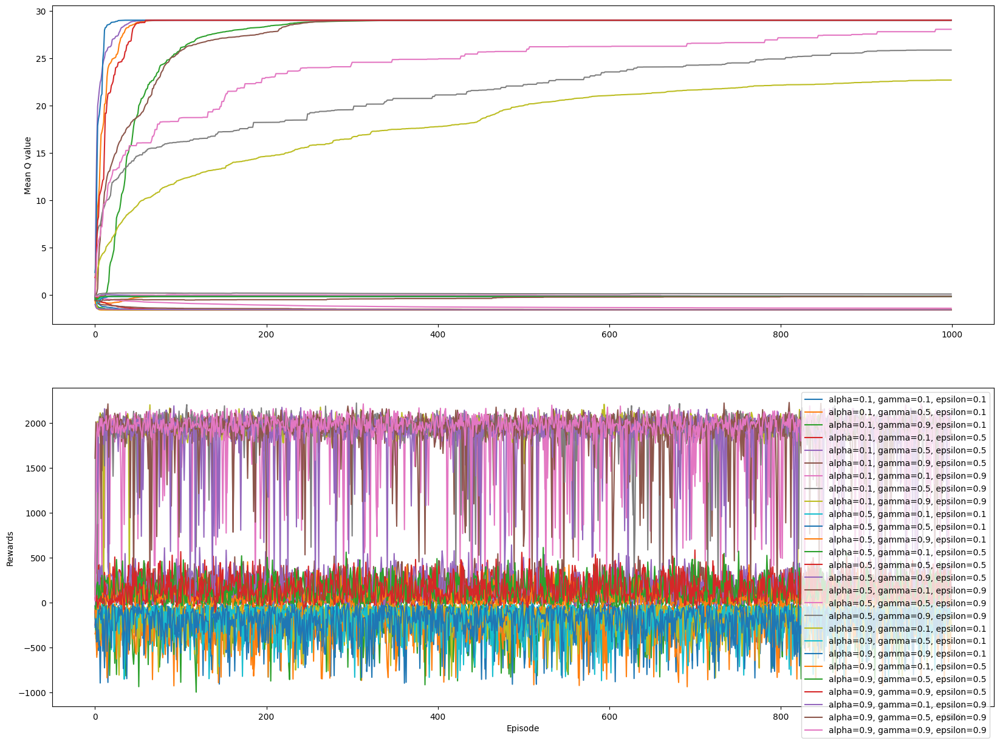

In [33]:
fig, ax = plt.subplots(2, figsize=(20, 15))
plt.xlabel('Episode')
ax[0].set_ylabel('Mean Q value')
ax[1].set_ylabel('Rewards')
for i, (means, rewards, label) in enumerate(zip(all_means, all_rewards, all_labels)):
    ax[0].plot(means, label=label)
    ax[1].plot(rewards, label=label)
plt.legend()